In [ ]:
  # sets *your* project id
PROJECT_ID = "Project_ID" #@param {type:"string"}

In [ ]:
# sets default dataset for AmsterdamUMCdb
DATASET_PROJECT_ID = 'amsterdamumcdb' #@param {type:"string"}
DATASET_ID = 'version1_0_2' #@param {type:"string"}
LOCATION = 'eu' #@param {type:"string"}

# **Obtain Authorization to access the database**



In [ ]:
import os
from google.colab import auth

# all libraries check this environment variable, so set it:
os.environ["GOOGLE_CLOUD_PROJECT"] = PROJECT_ID

auth.authenticate_user()
print('Authenticated')

Authenticated


# **Loading data using DataTable**


In [ ]:
%load_ext google.colab.data_table
from google.colab.data_table import DataTable
from google.colab import data_table
data_table.enable_dataframe_formatter()

# change default limits:
DataTable.max_columns = 50
DataTable.max_rows = 30000

The google.colab.data_table extension is already loaded. To reload it, use:
  %reload_ext google.colab.data_table


# **Creating a configuration query using "bigquery"**

In [ ]:
from google.cloud.bigquery import magics
from google.cloud import bigquery

# sets the default query job configuration
def_config = bigquery.job.QueryJobConfig(default_dataset=DATASET_PROJECT_ID + "." + DATASET_ID)
magics.context.default_query_job_config = def_config

## **Reading in admissions data**

In [ ]:
%%bigquery admissions
SELECT * FROM admissions

Query is running:   0%|          |

Downloading:   0%|          |

In [ ]:
admissions.head(1000)

,patientid,admissionid,admissioncount,location,urgency,origin,admittedat,admissionyeargroup,dischargedat,lengthofstay,destination,gender,agegroup,dateofdeath,weightgroup,weightsource,heightgroup,heightsource,specialty
0,117,130,1,MC,0,None,0,2003-2009,91560000,26,None,Man,70-79,<NA>,70-79,None,180-189,None,None
1,570,656,1,MC,0,None,0,2003-2009,90780000,25,None,Man,70-79,229442400000,60-69,None,160-169,None,None
2,700,799,1,MC,0,None,0,2003-2009,104460000,29,None,Man,60-69,<NA>,70-79,None,170-179,None,None
3,817,941,1,MC,0,None,0,2003-2009,86580000,24,None,Man,70-79,162649800000,60-69,None,160-169,None,None
4,951,1098,1,MC,0,None,0,2003-2009,75000000,20,None,,70-79,<NA>,60-69,None,170-179,None,None
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
995,1923,2211,1,IC,0,None,0,2010-2016,83940000,23,15,Vrouw,70-79,34519620000,70-79,None,170-179,None,Cardiochirurgie
996,1927,2215,1,IC,0,None,0,2003-2009,281400000,78,15,Vrouw,60-69,<NA>,90-99,None,160-169,None,Cardiochirurgie
997,1930,2218,1,IC,0,CCU/IC zelfde ziekenhuis,0,2010-2016,88500000,24,15,Man,60-69,<NA>,90-99,None,160-169,None,Cardiochirurgie
998,1934,2223,1,IC,0,None,0,2003-2009,70200000,19,15,Man,60-69,<NA>,70-79,None,170-179,None,Cardiochirurgie


**Using Python pandas to manipulate the tables**

In [ ]:
import pandas as pd

config_gbq = {'query':
          {'defaultDataset': {
              "datasetId": DATASET_ID,
              "projectId": DATASET_PROJECT_ID
              },
           'Location': LOCATION}
           }

In [ ]:
admissions['urgency'].value_counts()

0    16860
1     6246
Name: urgency, dtype: Int64

# **Overview of database**



*   ## This database contains data for the period 01/01/2003 - 31/12/2016.
*   ## Number of total admissions:23016
        Number of Planned admissions:16860
        Number of Emergency admissions:6246  
*   ## In this period, there are 5114 days; 3556 days are weekdays and 1461 days are weekends. There are 142 holidays, 45 days of them are the weekends. Therefore, we have 3556 working days and 1558 non-working days.

*  ## This period contains 730 weeks and 4 days.








In [ ]:
# Calculate the admission rates
avg_emergency_admission = round(6246/5114,2)
avg_planned_admission = round(16860/3556,2)

### **Creating a smaller table which includes data for "length of stays" and "urgency level" of each admission**

In [ ]:
df_admission = admissions[['patientid','admissionid','lengthofstay','urgency']].copy()

In [ ]:
df_admission.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 23106 entries, 0 to 23105
Data columns (total 4 columns):
 #   Column        Non-Null Count  Dtype
---  ------        --------------  -----
 0   patientid     23106 non-null  Int64
 1   admissionid   23106 non-null  Int64
 2   lengthofstay  23106 non-null  Int64
 3   urgency       23106 non-null  Int64
dtypes: Int64(4)
memory usage: 812.4 KB


### **Calculating "Number of Admissions" for each "Length of stays" for all admissions.**

In [ ]:
for value in df_admission['lengthofstay'].values:
  df_admission.loc[df_admission['lengthofstay'] == value, 'number_of_admissions']= df_admission['lengthofstay'].value_counts().at[value]
  df_admission.loc[df_admission['lengthofstay'] == value, 'probability']= df_admission['lengthofstay'].value_counts(normalize = True).at[value]

df_admission


### **Calculating "Number of Emergency Admissions" for each "Length of stays" for all admissions.**

In [ ]:
df_admission_emergency = df_admission.drop(columns=['probability'])

df_admission_emergency = df_admission_emergency.loc[df_admission['urgency']==1]
df_admission_emergency

### **Recalculating the probability of occurrence of a "Length of Stay" for emergency admissions**

In [ ]:
for value in df_admission_emergency['lengthofstay'].values:
  df_admission_emergency.loc[df_admission_emergency['lengthofstay'] == value, 'number_of_admissions']= df_admission_emergency['lengthofstay'].value_counts().at[value]
  df_admission_emergency.loc[df_admission_emergency['lengthofstay'] == value, 'probability']= df_admission_emergency['lengthofstay'].value_counts(normalize = True).at[value]

df_admission_emergency.sort_values('lengthofstay')

,patientid,admissionid,lengthofstay,urgency,number_of_admissions,probability
5244,3763,4333,0,1,1.0,0.000160
506,9123,10584,1,1,5.0,0.000801
13396,19217,22244,1,1,5.0,0.000801
724,20246,23457,1,1,5.0,0.000801
583,19891,23035,1,1,5.0,0.000801
...,...,...,...,...,...,...
7653,17868,20689,2323,1,1.0,0.000160
7911,4353,5006,2352,1,1.0,0.000160
7656,18181,21059,2470,1,1.0,0.000160
8946,5249,6056,3006,1,1.0,0.000160


### **A plot showing the distribution of emergency admissions based on their length of stays.**




<BarContainer object of 6051 artists>

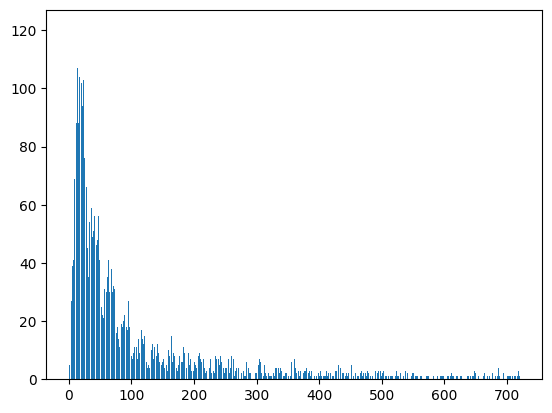

In [ ]:
from matplotlib import pyplot as plt
df_admission_emergency_short = df_admission_emergency[df_admission_emergency['lengthofstay']<=720]
plt.bar(df_admission_emergency_short['lengthofstay'],df_admission_emergency_short['number_of_admissions'])

<BarContainer object of 5586 artists>

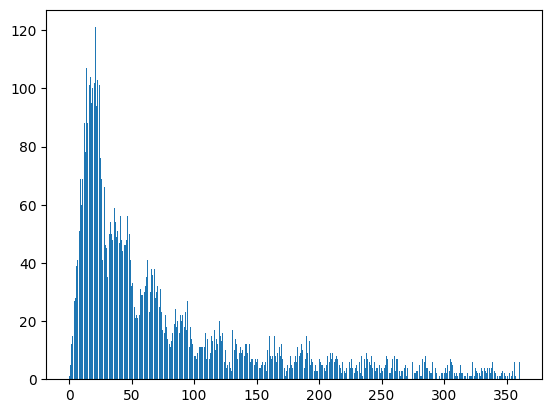

In [ ]:
from matplotlib import pyplot as plt
df_admission_emergency_veryshort = df_admission_emergency[df_admission_emergency['lengthofstay']<=360]
plt.bar(df_admission_emergency_veryshort['lengthofstay'],df_admission_emergency_veryshort['number_of_admissions'])

### **Calculating "Number of Planned Admissions" and their probability of occurrence for each "Length of Stays" for all admissions.**

In [ ]:
df_admission_planned = df_admission.drop(columns=['probability'])
df_admission_planned = df_admission_planned.loc[df_admission['urgency']==0]
for value in df_admission_planned['lengthofstay'].values:
  df_admission_planned.loc[df_admission_planned['lengthofstay'] == value, 'number_of_admissions']= df_admission_planned['lengthofstay'].value_counts().at[value]
  df_admission_planned.loc[df_admission_planned['lengthofstay'] == value, 'probability']= df_admission_planned['lengthofstay'].value_counts(normalize = True).at[value]

df_admission_planned.sort_values('lengthofstay')

,patientid,admissionid,lengthofstay,urgency,number_of_admissions,probability
361,7650,8872,0,0,19.0,0.001127
358,7040,8165,0,0,19.0,0.001127
367,8799,10206,0,0,19.0,0.001127
368,9012,10458,0,0,19.0,0.001127
349,5068,5850,0,0,19.0,0.001127
...,...,...,...,...,...,...
8174,12865,14910,3201,0,1.0,0.000059
7539,7978,9265,3855,0,1.0,0.000059
7435,19290,22324,4380,0,1.0,0.000059
17406,9827,11384,4850,0,1.0,0.000059


### **A plot showing the distribution of planned admissions based on their length of stays.**

<BarContainer object of 15718 artists>

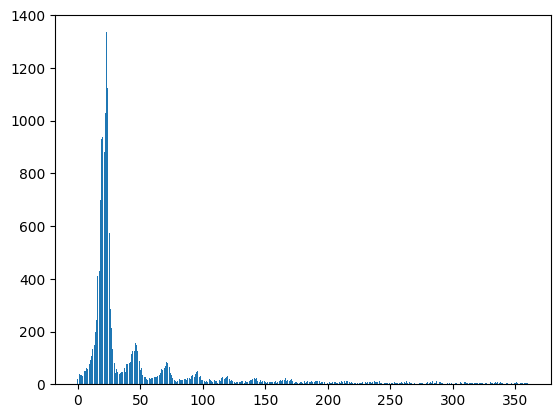

In [ ]:
from matplotlib import pyplot as plt
df_admission_planned_veryshort = df_admission_planned[df_admission_planned['lengthofstay']<=360]
plt.bar(df_admission_planned_veryshort['lengthofstay'],df_admission_planned_veryshort['number_of_admissions'])

#Datasets creation for Pandemic Simulation

In [ ]:
#function for left (sql) join of datasets for adding variables for simulation
def left_join(df1, df2):
  df1=pd.merge(left=df1,
         right=df2,
         how = "left",
         on="admissionid")
  return df1

### **Preparing a table which includes data of $PaO_2$ and $FiO_2$**

In [ ]:
admissions_ards = admissions.copy(deep=True)

In [ ]:
%%bigquery pao2_fio2
     WITH fio2_table AS (
    SELECT n.admissionid,
        n.measuredat,
        l.valueid,
        l.value AS o2_device,
        CASE
            WHEN n.itemid IN (
                --FiO2 settings on respiratory support
                6699, --FiO2 %: setting on Evita ventilator
                12279, --O2 concentratie --measurement by Servo-i/Servo-U ventilator
                12369, --SET %O2: used with BiPap Vision ventilator
                16246 --Zephyros FiO2: Non-invasive ventilation
            ) THEN TRUE
            ELSE FALSE
        END AS ventilatory_support,
        n.itemid,
        CASE
            WHEN n.itemid IN (
                --FiO2 settings on respiratory support
                6699, --FiO2 %: setting on Evita ventilator
                12279, --O2 concentratie --measurement by Servo-i/Servo-U ventilator
                12369, --SET %O2: used with BiPap Vision ventilator
                16246 --Zephyros FiO2: Non-invasive ventilation
            ) THEN
                CASE
                    WHEN NOT n.value IS NULL THEN n.value --use the settings
                    ELSE 0.21
                END
            ELSE -- estimate the FiO2
                CASE
                    WHEN l.valueid IN (
                        2, -- Nasaal
                        7 --O2-bril
                    ) THEN
                        CASE
                            WHEN n.value >= 1 AND n.value < 2 THEN 0.22
                            WHEN n.value >= 2 AND n.value < 3 THEN 0.25
                            WHEN n.value >= 3 AND n.value < 4 THEN 0.27
                            WHEN n.value >= 4 AND n.value < 5 THEN 0.30
                            WHEN n.value >= 5 THEN 0.35
                            ELSE 0.21
                        END
                    WHEN l.valueid IN (
                        1, --Diep Nasaal
                        3, --Kapje
                        8, --Kinnebak
                        9, --Nebulizer
                        4, --Kunstneus
                        18, --Spreekcanule
                        19 --Spreekklepje
                    ) THEN
                        CASE
                            WHEN n.value >= 1 AND n.value < 2 THEN 0.22 -- not defined by NICE
                            WHEN n.value >= 2 AND n.value < 3 THEN 0.25
                            WHEN n.value >= 3 AND n.value < 4 THEN 0.27
                            WHEN n.value >= 4 AND n.value < 5 THEN 0.30
                            WHEN n.value >= 5 AND n.value < 6 THEN 0.35
                            WHEN n.value >= 6 AND n.value < 7 THEN 0.40
                            WHEN n.value >= 7 AND n.value < 8 THEN 0.45
                            WHEN n.value >= 8 THEN 0.50
                            ELSE 0.21
                        END
                    WHEN l.valueid IN (
                        10, --Waterset
                        11, --Trach.stoma
                        13, --Ambu
                        14, --Guedel
                        15, --DL-tube
                        16, --CPAP
                        17 --Non-Rebreathing masker
                    ) THEN
                        CASE
                            WHEN n.value >= 6 AND n.value < 7 THEN 0.60
                            WHEN n.value >= 7 AND n.value < 8 THEN 0.70
                            WHEN n.value >= 8 AND n.value < 9 THEN 0.80
                            WHEN n.value >= 9 AND n.value < 10 THEN 0.85
                            WHEN n.value >= 10 THEN 0.90
                            ELSE 0.21
                        END
                    WHEN l.valueid IN (
                        12 --B.Lucht
                    ) THEN 0.21
                ELSE 0.21
            END
        END AS fio2
    FROM numericitems n
    LEFT JOIN admissions a ON
        n.admissionid = a.admissionid
    LEFT JOIN listitems l ON
        n.admissionid = l.admissionid AND
        n.measuredat = l.measuredat AND
        l.itemid = 8189 -- Toedieningsweg (Oxygen device)
    WHERE
        n.itemid IN (
            --Oxygen Flow settings without respiratory support
            8845, -- O2 l/min
            10387, --Zuurstof toediening (bloed)
            18587, --Zuurstof toediening

            --FiO2 settings on respiratory support
            6699, --FiO2 %: setting on Evita ventilator
            12279, --O2 concentratie --measurement by Servo-i/Servo-U ventilator
            12369, --SET %O2: used with BiPap Vision ventilator
            16246 --Zephyros FiO2: Non-invasive ventilation
        )
    --measurements within 24 hours of ICU stay:
    AND (n.measuredat - a.admittedat) <= 1000*60*60*24 AND (n.measuredat - a.admittedat) >= 0
    AND n.value > 0 --ignore stand by values from Evita ventilator
),
oxygenation AS (
    SELECT
        pao2.admissionid,
        CASE pao2.unitid
            WHEN 152 THEN ROUND(CAST(pao2.value * 7.50061683 AS NUMERIC), 1) -- Conversion: kPa to mmHg
            ELSE pao2.value
        END AS pao2,
        f.value AS specimen_source,
        CASE
            WHEN UPPER(pao2.registeredby) NOT LIKE UPPER('%Systeem%') THEN TRUE
            ELSE FALSE
        END AS manual_entry,
        (pao2.measuredat - a.admittedat)/(1000*60) AS time,
        fio2_table.fio2,
        fio2_table.ventilatory_support,
        (fio2_table.measuredat - pao2.measuredat)/(60*1000) AS fio2_time_difference,
        ROW_NUMBER() OVER(
            PARTITION BY pao2.admissionid, pao2.measuredat
            ORDER BY
                CASE
                    --FiO2 settings on respiratory support
                    WHEN fio2_table.itemid = 12279 THEN 1 --O2 concentratie --measurement by Servo-i/Servo-U ventilator
                    WHEN fio2_table.itemid = 6699 THEN 2 --FiO2 %: setting on Evita ventilator
                    WHEN fio2_table.itemid = 12369 THEN 3 --SET %O2: used with BiPap Vision ventilator
                    WHEN fio2_table.itemid = 16246 THEN 4--Zephyros FiO2: Non-invasive ventilation
                    --Oxygen Flow settings without respiratory support
                    WHEN fio2_table.itemid = 8845 THEN 5 -- O2 l/min
                    WHEN fio2_table.itemid = 10387 THEN 6 --Zuurstof toediening (bloed)
                    WHEN fio2_table.itemid = 18587 THEN 7 --Zuurstof toediening
                END, --prefer ventilator measurements over manually entered O2 settings
                CASE
                    WHEN fio2_table.measuredat <= pao2.measuredat THEN 1 --prefer FiO2 settings before blood gas measurement
                    ELSE 2
                END,
                ABS(fio2_table.measuredat - pao2.measuredat), --prefer FiO2 settings nearest to blood gas measurement
                CASE
                    WHEN pao2.itemid = 21214 THEN 1 --PO2 (bloed) - kPa
                    WHEN pao2.itemid = 9996 THEN 2 --PO2 (bloed)
                    WHEN pao2.itemid = 7433 THEN 3 --PO2
                END, --prefer PaO2 values from original measurement unit; same measurement could be reported twice
                CASE
                    WHEN paco2.itemid = 21213 THEN 1--PCO2 (bloed) - kPa
                    WHEN paco2.itemid = 9990 THEN 2 --pCO2 (bloed)
                    WHEN  paco2.itemid = 6846 THEN 3 --PCO2
                END, --prefer PaCO2 values from original measurement unit; same measurement could be reported twice
                CASE
                    WHEN UPPER(f.value) LIKE UPPER('%art%') THEN 1
                    ELSE 2
                END, --prefer samples that haven been specified as arterial
                fio2_table.fio2 DESC --prefer highest (calculated) FiO2 for rare cases with multiple oxygen devices
        ) AS priority
    FROM numericitems pao2
    LEFT JOIN admissions a ON
        pao2.admissionid = a.admissionid
    LEFT JOIN freetextitems f ON
        pao2.admissionid = f.admissionid AND
        pao2.measuredat = f.measuredat AND
        f.itemid = 11646 --Afname (bloed): source of specimen
    LEFT JOIN numericitems paco2 ON
        pao2.admissionid = paco2.admissionid AND
        pao2.measuredat = paco2.measuredat AND
        paco2.itemid IN (
            6846, --PCO2
            9990, --pCO2 (bloed)
            21213 --PCO2 (bloed) - kPa
        )
    LEFT JOIN fio2_table ON
        pao2.admissionid = fio2_table.admissionid AND
        fio2_table.measuredat > pao2.measuredat - 60*60*1000 AND --no earlier than 60 minutes before pao2 measurement
        fio2_table.measuredat < pao2.measuredat + 15*60*1000 --no later than 15 minutes after pao2 measurement
    WHERE
        pao2.itemid IN (
            7433, --PO2
            9996, --PO2 (bloed)
            21214 --PO2 (bloed) - kPa
        )
    --measurements within 24 hours of ICU stay (use 30 minutes before admission to allow for time differences):
    AND (pao2.measuredat - a.admittedat) <= 1000*60*60*24 AND (pao2.measuredat - a.admittedat) >= -(1000*60*30) AND
    (UPPER(f.value) LIKE UPPER('%art%') OR f.value IS NULL)  -- source is arterial or undefined (assume arterial)
)
SELECT * FROM oxygenation
WHERE priority = 1


Query is running:   0%|          |

Downloading:   0%|          |

In [ ]:
pao2_fio2 = pao2_fio2
pao2_fio2.describe()

,admissionid,pao2,time,fio2,fio2_time_difference,priority
count,155784.0,155784.000000,155784.000000,128200.000000,128200.000000,155784.0
mean,11769.260534,113.975209,569.234344,32.488629,-18.149080,1.0
std,6784.435407,57.730326,414.314923,26.112568,18.966767,0.0
min,0.0,0.000000,-30.000000,0.210000,-59.000000,1.0
25%,5875.75,80.000000,198.000000,0.350000,-32.000000,1.0
50%,11784.5,100.000000,509.000000,40.000000,-13.000000,1.0
75%,17615.0,131.000000,901.000000,50.000000,0.000000,1.0
max,23551.0,2127.000000,1440.000000,570.000000,14.000000,1.0


In [ ]:
pao2_fio2.head(5)

,admissionid,pao2,specimen_source,manual_entry,time,fio2,ventilatory_support,fio2_time_difference,priority
0,38,167.0,Art.,False,437.0,41.00,True,8.0,1
1,134,86.0,Art.,False,335.0,30.00,True,9.0,1
2,292,161.0,None,True,300.0,40.00,True,2.0,1
3,360,90.0,ART.,False,619.0,0.25,False,9.0,1
4,789,84.0,ART.,False,1129.0,52.00,True,14.0,1


In [ ]:
pao2_fio2 = pao2_fio2[(pao2_fio2["pao2"]<645.59) & (pao2_fio2["pao2"]>50)]

In [ ]:
pao2_fio2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 149769 entries, 0 to 155783
Data columns (total 9 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   admissionid           149769 non-null  Int64  
 1   pao2                  149769 non-null  float64
 2   specimen_source       113887 non-null  object 
 3   manual_entry          149769 non-null  boolean
 4   time                  149769 non-null  float64
 5   fio2                  123073 non-null  float64
 6   ventilatory_support   123073 non-null  boolean
 7   fio2_time_difference  123073 non-null  float64
 8   priority              149769 non-null  Int64  
dtypes: Int64(2), boolean(2), float64(4), object(1)
memory usage: 10.0+ MB


In [ ]:
#convert values of fio2, if value less than 1 it is for sure an index, multipluing by 100 convert it to percents
pao2_fio2['fio2'] = pao2_fio2['fio2'].apply(lambda x: x*100 if x<1 else x)
pao2_fio2.head(5)

<ipython-input-30-31b5f66c615a>:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  pao2_fio2['fio2'] = pao2_fio2['fio2'].apply(lambda x: x*100 if x<1 else x)


,admissionid,pao2,specimen_source,manual_entry,time,fio2,ventilatory_support,fio2_time_difference,priority
0,38,167.0,Art.,False,437.0,41.0,True,8.0,1
1,134,86.0,Art.,False,335.0,30.0,True,9.0,1
2,292,161.0,None,True,300.0,40.0,True,2.0,1
3,360,90.0,ART.,False,619.0,25.0,False,9.0,1
4,789,84.0,ART.,False,1129.0,52.0,True,14.0,1


In [ ]:
#only valid values left
pao2_fio2 = pao2_fio2[(pao2_fio2["fio2"]>21.0)&(pao2_fio2["fio2"]<100.0)]

In [ ]:
pao2_fio2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 118996 entries, 0 to 155782
Data columns (total 9 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   admissionid           118996 non-null  Int64  
 1   pao2                  118996 non-null  float64
 2   specimen_source       86962 non-null   object 
 3   manual_entry          118996 non-null  boolean
 4   time                  118996 non-null  float64
 5   fio2                  118996 non-null  float64
 6   ventilatory_support   118996 non-null  boolean
 7   fio2_time_difference  118996 non-null  float64
 8   priority              118996 non-null  Int64  
dtypes: Int64(2), boolean(2), float64(4), object(1)
memory usage: 7.9+ MB


### **Calculating the ratio of normalized $PaO_2$ and $FiO_2$ in order to calculate "Sofa Respiration Score"**

Sofa Score is classified as an integer in the range $[0,4]$:
*  If $PaO_2/FiO_2 ≥ 400$ $⟶$ Sofa Respiration Score = 0
*  If $PaO_2/FiO_2 < 400 ~~ \& ~~ PaO_2/FiO_2 ≥ 300$  $⟶$ Sofa Respiration Score = 1
*  If $PaO_2/FiO_2 < 300 ~~ \& ~~ PaO_2/FiO_2 ≥ 200$ $⟶$ Sofa Respiration Score = 2
*  If $PaO_2/FiO_2 < 200 ~~ \& ~~ PaO_2/FiO_2 ≥ 100$ $⟶$ Sofa Respiration Score = 3
*  If $PaO_2/FiO_2 < 100 $ $⟶$ Sofa Respiration Score = 4



In [ ]:
pao2_fio2['pao2/fio2']= round(pao2_fio2['pao2']/pao2_fio2['fio2']*100,0)
pao2_fio2.head(5)
pao2_fio2['pao2/fio2'].describe()

count    118996.000000
mean        272.037052
std         123.387130
min          52.000000
25%         186.000000
50%         251.000000
75%         340.000000
max        1873.000000
Name: pao2/fio2, dtype: float64

In [ ]:
#calculate SOFA respiration score:
pao2_fio2.loc[:,'sofa_respiration_score'] = 0
pao2_fio2.loc[(pao2_fio2['pao2/fio2'] < 400) &
                     (pao2_fio2['pao2/fio2'] >= 300), 'sofa_respiration_score'] = 1
pao2_fio2.loc[(pao2_fio2['pao2/fio2'] < 300), 'sofa_respiration_score'] = 2
pao2_fio2.loc[(pao2_fio2['pao2/fio2'] < 200) & (pao2_fio2['pao2/fio2'] >= 100) &
                     (pao2_fio2['ventilatory_support'] == True), 'sofa_respiration_score'] = 3
pao2_fio2.loc[(pao2_fio2['pao2/fio2'] < 100) &
                     (pao2_fio2['ventilatory_support'] == True), 'sofa_respiration_score'] = 4
pao2_fio2.head()

,admissionid,pao2,specimen_source,manual_entry,time,fio2,ventilatory_support,fio2_time_difference,priority,pao2/fio2,sofa_respiration_score
0,38,167.0,Art.,False,437.0,41.0,True,8.0,1,407.0,0
1,134,86.0,Art.,False,335.0,30.0,True,9.0,1,287.0,2
2,292,161.0,None,True,300.0,40.0,True,2.0,1,403.0,0
3,360,90.0,ART.,False,619.0,25.0,False,9.0,1,360.0,1
4,789,84.0,ART.,False,1129.0,52.0,True,14.0,1,162.0,3


In [ ]:
pao2_fio2_tomerge = pao2_fio2[['admissionid', "sofa_respiration_score"]]
pao2_fio2_tomerge

In [ ]:
pao2_fio2_tomerge.describe()

,admissionid,sofa_respiration_score
count,118996.0,118996.000000
mean,11765.292413,1.759639
std,6777.313973,1.013499
min,0.0,0.000000
25%,5883.0,1.000000
50%,11798.0,2.000000
75%,17590.0,2.000000
max,23551.0,4.000000


In [ ]:
pao2_fio2_tomerge = pao2_fio2_tomerge.groupby('admissionid').agg(max)
pao2_fio2_tomerge


,sofa_respiration_score
admissionid,
0,3
1,2
2,2
3,2
4,3
...,...
23546,3
23547,3
23548,1


### **Making a list for all admissions wich includes patients with Acute Respiratory Distress Syndrome (ARDS) based on their Sofa respiratory score**

In [ ]:
admissions_ards = left_join(admissions_ards, pao2_fio2_tomerge)


In [ ]:
admissions_ards.head(5)

,patientid,admissionid,admissioncount,location,urgency,origin,admittedat,admissionyeargroup,dischargedat,lengthofstay,destination,gender,agegroup,dateofdeath,weightgroup,weightsource,heightgroup,heightsource,specialty,sofa_respiration_score
0,117,130,1,MC,0,None,0,2003-2009,91560000,26,None,Man,70-79,<NA>,70-79,None,180-189,None,None,2.0
1,570,656,1,MC,0,None,0,2003-2009,90780000,25,None,Man,70-79,229442400000,60-69,None,160-169,None,None,2.0
2,700,799,1,MC,0,None,0,2003-2009,104460000,29,None,Man,60-69,<NA>,70-79,None,170-179,None,None,3.0
3,817,941,1,MC,0,None,0,2003-2009,86580000,24,None,Man,70-79,162649800000,60-69,None,160-169,None,None,2.0
4,951,1098,1,MC,0,None,0,2003-2009,75000000,20,None,,70-79,<NA>,60-69,None,170-179,None,None,3.0


In [ ]:
admissions_ards['sofa_respiration_score'].value_counts()

2.0    7779
3.0    6468
1.0    2834
0.0    1835
4.0    1273
Name: sofa_respiration_score, dtype: int64

In [ ]:
admissions_ards = admissions_ards.loc[admissions_ards['sofa_respiration_score']>=2]
#only patients with sofa respration score 2 or more left in the dataset

In [ ]:
admissions_ards.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15520 entries, 0 to 23105
Data columns (total 20 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   patientid               15520 non-null  Int64  
 1   admissionid             15520 non-null  Int64  
 2   admissioncount          15520 non-null  Int64  
 3   location                15520 non-null  object 
 4   urgency                 15520 non-null  Int64  
 5   origin                  5793 non-null   object 
 6   admittedat              15520 non-null  Int64  
 7   admissionyeargroup      15520 non-null  object 
 8   dischargedat            15520 non-null  Int64  
 9   lengthofstay            15520 non-null  Int64  
 10  destination             15338 non-null  object 
 11  gender                  15520 non-null  object 
 12  agegroup                15520 non-null  object 
 13  dateofdeath             5587 non-null   Int64  
 14  weightgroup             15011 non-null

In [ ]:
admissions_ards.groupby('sofa_respiration_score')['lengthofstay'].mean()
#worst respiration score have more los

sofa_respiration_score
2.0      89.64507
3.0    174.947279
4.0    284.794187
Name: lengthofstay, dtype: Float64

In [ ]:
df_admission_ards = admissions_ards[['patientid','admissionid','lengthofstay','urgency','sofa_respiration_score']].copy()

In [ ]:
df_admission_ards.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 15520 entries, 0 to 23105
Data columns (total 5 columns):
 #   Column                  Non-Null Count  Dtype  
---  ------                  --------------  -----  
 0   patientid               15520 non-null  Int64  
 1   admissionid             15520 non-null  Int64  
 2   lengthofstay            15520 non-null  Int64  
 3   urgency                 15520 non-null  Int64  
 4   sofa_respiration_score  15520 non-null  float64
dtypes: Int64(4), float64(1)
memory usage: 788.1 KB


### **Calculating "Number of ARDS Admissions" and their probability of occurrence for each "Length of Stays" for all admissions.**

In [ ]:
for value in df_admission_ards['lengthofstay'].values:
  df_admission_ards.loc[df_admission_ards['lengthofstay'] == value, 'number_of_admissions']= df_admission_ards['lengthofstay'].value_counts().at[value]
  df_admission_ards.loc[df_admission_ards['lengthofstay'] == value, 'probability']= df_admission_ards['lengthofstay'].value_counts(normalize = True).at[value]

df_admission_ards


,patientid,admissionid,lengthofstay,urgency,sofa_respiration_score,number_of_admissions,probability
0,117,130,26,0,2.0,260.0,0.016753
1,570,656,25,0,2.0,482.0,0.031057
2,700,799,29,0,3.0,90.0,0.005799
3,817,941,24,0,2.0,929.0,0.059858
4,951,1098,20,0,3.0,568.0,0.036598
...,...,...,...,...,...,...,...
23100,20077,23256,22,0,3.0,771.0,0.049678
23101,20155,23348,65,0,2.0,57.0,0.003673
23103,20246,23459,62,0,3.0,46.0,0.002964
23104,20266,23483,26,0,3.0,260.0,0.016753


In [ ]:
df_admission_ards['urgency'].value_counts()

0    11560
1     3960
Name: urgency, dtype: Int64

### **A plot showing the distribution of ARDS admissions based on their length of stays.**

<BarContainer object of 14914 artists>

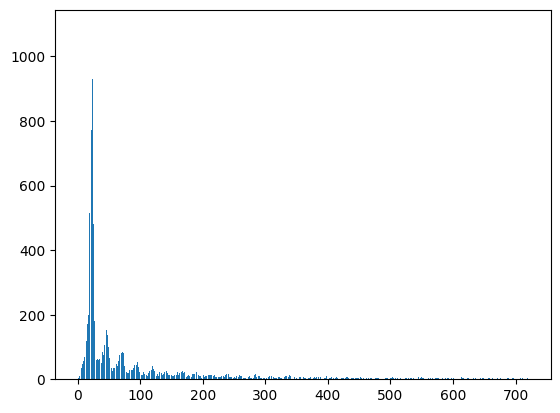

In [ ]:
from matplotlib import pyplot as plt
df_admission_ards_short = df_admission_ards[df_admission_ards['lengthofstay']<=720]
plt.bar(df_admission_ards_short['lengthofstay'],df_admission_ards_short['number_of_admissions'])

In [ ]:
df_admission_ards['lengthofstay'].median()

40.0

# **To run the simulation for one time and to see the relevant data and plots, run the following blocks. If you want to run the simulation more than once go to the next block.**


## **Description of Simulation**
I have written the simulation code using SimPy simulation framework of Python. It runs for 365 days. The ICU bed occupancy gets updated at the end of each days. This simulation has a two-fold application. It can predict the bed occupancy in a normal condition based on data provided by Amsterdam UMC database . Moreover, based on the extracted data from the database for all patients with ARDS a pandemic-like simulation is also executed. Both situations are within the same code; to achieve either a normal or a pandemic-like situation, one can change the values of the relevant variables in  the code.

In [ ]:
!pip install simpy

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
from pickle import FALSE
import random
import simpy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime, timedelta


## **Simulating ICU admissions at a given day**


---



### **Calculating ICU admisssion rate for the simulation**


We use three different approaches to do so:

1.   Using a Log-Normal Distribution with the mean ($\mu$ parameter) of logarithm of distribution obtained from the real data, $\mu = \log{(\textrm{average admissions})}$
2.   Using a Poisson Distribution with the mean of length of stay obtained from the real data, based on Amesterdam UCM database $\textrm{mean} = 22$ (see above plots).
3.   Random choice of lengths of stays wighted using the probability of Planned, Emergency or Pandemic ARDS distribution calculated above.


**Note 1: In this simulation, we have considered that Planned admissions only occur on weekdays while Emergency admissions happen every day.**

**Note 2: We have assumed a $\mu$ parameter for the pandemic simulation as $ \mu_{\textrm{Pandemic}} = 2(\mu_{\textrm{Planned}} + \mu_{\textrm{Emergency}})$.**



In [ ]:
# Calculate the admission rates

avg_emergency_admission = 6246/5114
avg_planned_admission = 16860/3556
emergency_mu_parameter = np.log(avg_emergency_admission)
planned_mu_parameter = np.log(avg_planned_admission)
pandemic_mu_parameter = 2*(planned_mu_parameter + emergency_mu_parameter)


# Define the number of ICU beds
icu_beds = 20

# Initialize the extra_beds_needed variable
extra_beds_needed = 1


In [ ]:
# Function to simulate ICU admissions for a given day
def simulate_admissions(env, real_data, use_poisson_distribution,pandemic, mean_length_of_stay):
    # Get the current date and check if it's a weekday or weekend
    current_day = env.now  # Increment by 1 since simulation starts from day 0
    is_weekday = current_day % 7 < 5  # Monday = 0, ..., Friday = 4


    #print(f'today value is{current_day}')

    # Define the planned admission rate (number of planned admissions per weekday)
    planned_admission_rate = round(np.random.lognormal(planned_mu_parameter,sigma=0.5))

    # Define the number of emergency admissions per day (can vary)
    emergency_admission_rate = round(np.random.lognormal(emergency_mu_parameter,sigma=0.5))

    # Define the pandemic admission rate (number of pandemic admissions)
    pandemic_admission_rate = round(np.random.lognormal(pandemic_mu_parameter,sigma=0.5))

    # Simulate ICU admissions for the day
    if use_poisson_distribution:
        if pandemic:
          admissions = np.random.poisson(mean_length_of_stay, pandemic_admission_rate)
        else:
          admissions_emergency = np.random.poisson(mean_length_of_stay, emergency_admission_rate)
          admissions_planned = np.random.poisson(mean_length_of_stay, planned_admission_rate)
          # Calculate the total admission rate based on the type of admission
          if is_weekday:
            admissions = np.append(admissions_emergency, admissions_planned)
          else:
            admissions = admissions_emergency

          print(f"admission was selected from a random Poisson distribution with mean ={mean_length_of_stay}")
    else:
        if pandemic:
          admissions = np.random.choice(pandemic_length_of_stay_distribution, size = pandemic_admission_rate, p=pandemic_probability_length_of_stay_data_array)
        else:

          admissions_emergency = np.random.choice(emergency_length_of_stay_distribution, size = emergency_admission_rate, p=emergency_probability_length_of_stay_data_array)
          admissions_planned = np.random.choice(planned_length_of_stay_distribution, size = planned_admission_rate, p=planned_probability_length_of_stay_data_array)
          # Calculate the total admission rate based on the type of admission
          if is_weekday:
            admissions = np.append(admissions_emergency, admissions_planned)
            #print(f'admission on weekday')
            #print(f'number of admissions:{len(admissions)}')
          else:
            admissions = admissions_emergency
            #print(f'admission on not_a_weekday')
            #print(f'number of admissions:{len(admissions)}')

            #admissions = np.random.choice(length_of_stay_distribution, size = total_admission_rate, p=probability_length_of_stay_data_array)
            #print(f'admission:{admissions}')
    admission_priority = [0] * planned_admission_rate + [1] * emergency_admission_rate

    return admissions, admission_priority, pandemic_admission_rate

### **This Function updates the ICU bed occupancy at the end of each day of simulation by taking into account the discharged patients on each day of simulation**

In [ ]:
# Function to update occupancy and occupied beds
def update_occupancy(admissions, icu_beds_capacity, occupied_beds):
    # Extend occupied_beds by admissions
    occupied_beds.extend(admissions)
    beginning_of_day_occupancy = len(occupied_beds)

    # Check if the size of ocupied_beds is smaller than the number of icu_beds
 #   if len(occupied_beds) < icu_beds_capacity.capacity:
        # Change occupied_beds to a list only containing values bigger than 24
        # and subtract 24 from the remaining values
    occupied_beds = [(val - 24) for val in occupied_beds if val > 24]

    end_of_day_occupancy = len(occupied_beds)
    discharged = beginning_of_day_occupancy - end_of_day_occupancy
    occupancy = beginning_of_day_occupancy - discharged



    return beginning_of_day_occupancy, occupancy, occupied_beds



## **Function to define the Simulation Process**

In [ ]:
# Simulation process
def simulate_icu_occupancy(env, icu_beds_capacity, extra_beds_needed, mean_length_of_stay):
    occupancy = 0
    occupied_beds = []
    bed_capacity_reached = False

    half_time = 365 / 2

    current_day = 0  # Initialize current_day to 0, SIMULATION STARTS ON MONDAY

    while True:
        admissions, admission_priority, pandemic_admission_rate = simulate_admissions(env, real_data, use_poisson_distribution,pandemic, mean_length_of_stay)

        with icu_beds_capacity.request(priority=max(admission_priority)) as request:
            yield request

            beginning_of_day_occupancy, occupancy, occupied_beds = update_occupancy(admissions, icu_beds_capacity, occupied_beds)

            # Append data to occupancy and bed capacity lists
            occupancy_BOD_data.append(beginning_of_day_occupancy)
            occupancy_EOD_data.append(occupancy)
            bed_capacity_data.append(icu_beds_capacity.capacity)
            #admission_rate_data.append(total_admission_rate)
            emergency_admission_rate_data.append(admission_priority.count(1))
            planned_admission_rate_data.append(admission_priority.count(0))
            pandemic_admission_rate_data.append(pandemic_admission_rate)







        yield env.timeout(1)
        current_day += 1  # Increment current_day by 1 after each simulation loop

## **Deciding that which of the calculations for admission rate we use and calculate the relevant data to compute the corresponding distributions**

In [ ]:
# Define the length of stay distribution

use_poisson_distribution = False
real_data = True
pandemic = True
mean_length_of_stay = 22

if use_poisson_distribution:
    mean_length_of_stay = 22  # Mean length of stay for Poisson distribution

elif real_data :     # Set to True if using real data

    emergency_length_of_stay_data = df_admission_emergency['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    emergency_probability_length_of_stay_data = df_admission_emergency['probability']

    emergency_length_of_stay_data_array = emergency_length_of_stay_data.values
    emergency_probability_length_of_stay_data_array = emergency_probability_length_of_stay_data.values

    planned_length_of_stay_data = df_admission_planned['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    planned_probability_length_of_stay_data = df_admission_planned['probability']

    planned_length_of_stay_data_array = planned_length_of_stay_data.values
    planned_probability_length_of_stay_data_array = planned_probability_length_of_stay_data.values

    pandemic_length_of_stay_data = df_admission_ards['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    pandemic_probability_length_of_stay_data = df_admission_ards['probability']

    pandemic_length_of_stay_data_array = pandemic_length_of_stay_data.values
    pandemic_probability_length_of_stay_data_array = pandemic_probability_length_of_stay_data.values


    # Normalize the probabilities
    emergency_probability_length_of_stay_data_array /= np.sum(emergency_probability_length_of_stay_data_array)
    planned_probability_length_of_stay_data_array /= np.sum(planned_probability_length_of_stay_data_array)
    pandemic_probability_length_of_stay_data_array /= np.sum(pandemic_probability_length_of_stay_data.array)

    emergency_length_of_stay_distribution = emergency_length_of_stay_data_array

    planned_length_of_stay_distribution = planned_length_of_stay_data_array

    pandemic_length_of_stay_distribution = pandemic_length_of_stay_data_array


    print(f"Admissions were selected from a choice of real data based on a log-normal distributaion with sigma = 0.5 and mu = ({planned_mu_parameter},{emergency_mu_parameter}) for planned and emergency admissions respectively.")
else:
    emergency_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    planned_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    pandemic_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    print(f"Admissions was selected from a random selection of random integer numbers")



Admissions were selected from a choice of real data based on a log-normal distributaion with sigma = 0.5 and mu = (1.5563076349220513,0.19995938199189203) for planned and emergency admissions respectively.


## **Initializing empty lists to store data for bed occupancy and admission rates on each day of simulation**

In [ ]:
# Create lists to store occupancy and bed capacity data
occupancy_BOD_data = []
occupancy_EOD_data = []
bed_capacity_data = []
#admission_rate_data = []
emergency_admission_rate_data = []
planned_admission_rate_data = []
pandemic_admission_rate_data = []


## **Setting the Simulation environment and ruuning it for 365 days of simulation**

In [ ]:
# Run the simulation
env = simpy.Environment()
icu_beds_capacity = simpy.PriorityResource(env, capacity=icu_beds)
extra_beds_needed = simpy.Resource(env, capacity=extra_beds_needed)
simulation = env.process(simulate_icu_occupancy(env, icu_beds_capacity, extra_beds_needed,  mean_length_of_stay))
env.run(until=365)


## **Making a table of collected data from simulation and Plotting them**

In [ ]:
# Print the simulation results

# Create a pandas DataFrame
data = {'Planned admissions': planned_admission_rate_data, 'Emergency admissions': emergency_admission_rate_data, 'Pandemic admissions': pandemic_admission_rate_data, 'Beds occupied during the day': occupancy_BOD_data, 'Occupancy at the end of day': occupancy_EOD_data, 'Bed Capacity': bed_capacity_data}
df_data = pd.DataFrame(data)

# Print the DataFrame
df_data


,Planned admissions,Emergency admissions,Pandemic admissions,Beds occupied during the day,Occupancy at the end of day,Bed Capacity
0,4,1,41,41,8,20
1,8,2,69,77,11,20
2,5,1,23,34,9,20
3,6,3,37,46,8,20
4,5,1,27,35,9,20
...,...,...,...,...,...,...
360,6,1,44,76,19,20
361,3,1,32,51,20,20
362,2,2,37,57,17,20
363,4,1,33,50,16,20


**Description of Plot:**

* Blue plot is depicting the number of occupied beds at the end of each day of simulation

* Orange plot is depicting the maximum number of occupied beds at each day of simulation

**Note: At the beginning of each day of simulation all admitted patients are counted. Due to the removal of time stamp from data for anonymization purposes, we could not input admission data in an hourly base.**

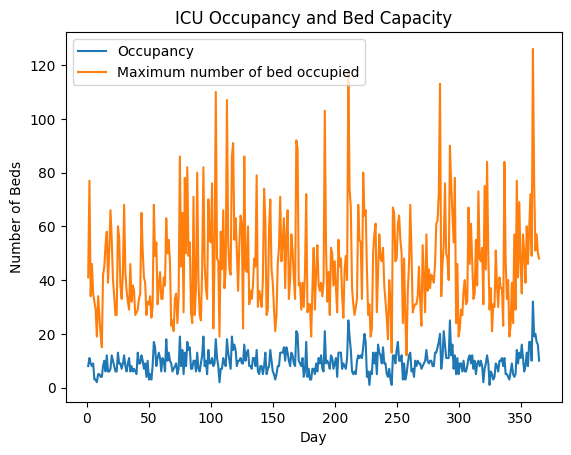

In [ ]:
# Plot the occupancy and bed capacity data
days = np.arange(1, len(occupancy_EOD_data) + 1)

plt.plot(days, occupancy_EOD_data, label='Occupancy')
plt.plot(days, occupancy_BOD_data, label='Maximum number of bed occupied')
plt.xlabel('Day')
plt.ylabel('Number of Beds')
plt.title('ICU Occupancy and Bed Capacity')
plt.legend()
plt.show()

In [ ]:
df_data['Beds occupied during the day'].nlargest(10)

359    126
210    118
284    113
103    110
112    107
191    103
168     92
117     91
292     90
169     89
Name: Beds occupied during the day, dtype: int64

In [ ]:
df_data['Beds occupied during the day'].max()

126

# **To have a better grasp at the statiscs behind the simulation, we create an ensemble of simulations.**

## **To run the simulation for 1000 times and compre the maximum number of occupancy run the following block.**

### **Note: Following code is for a PANDEMIC simulation. Change the value of "pandemic = True" in order to run the simulation for a normal situation.**

In [ ]:
from pickle import FALSE
import random
import simpy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime, timedelta






# Calculate the admission rates
#avg_emergency_admission = round(6246/5114,2)
#avg_planned_admission = round(16860/3556,2)
avg_emergency_admission = 6246/5114
avg_planned_admission = 16860/3556
emergency_mu_parameter = np.log(avg_emergency_admission)
planned_mu_parameter = np.log(avg_planned_admission)
pandemic_mu_parameter = 2*(planned_mu_parameter + emergency_mu_parameter)




# Define the number of ICU beds
icu_beds = 20

# Initialize the extra_beds_needed variable
extra_beds_capacity = 1

# Create lists to store occupancy and bed capacity data for each run
all_occupancy_BOD_data = []
all_occupancy_EOD_data = []
all_bed_capacity_data = []
#all_admission_rate_data = []
all_emergency_admissions_rate_data = []
all_planned_admissions_rate_data = []
all_pandemic_admissions_rate_data = []


# Function to simulate ICU admissions for a given day
def simulate_admissions(env, real_data, use_poisson_distribution,pandemic, mean_length_of_stay):
    # Get the current date and check if it's a weekday or weekend
    current_day = env.now  # Increment by 1 since simulation starts from day 0
    is_weekday = current_day % 7 < 5  # Monday = 0, ..., Friday = 4


    #print(f'today value is{current_day}')

    # Define the planned admission rate (number of planned admissions per weekday)
    planned_admission_rate = round(np.random.lognormal(planned_mu_parameter,sigma=0.5))

    # Define the number of emergency admissions per day (can vary)
    emergency_admission_rate = round(np.random.lognormal(emergency_mu_parameter,sigma=0.5))

    # Define the pandemic admission rate (number of pandemic admissions)
    pandemic_admission_rate = round(np.random.lognormal(pandemic_mu_parameter,sigma=0.5))

    # Simulate ICU admissions for the day
    if use_poisson_distribution:
        if pandemic:
          admissions = np.random.poisson(mean_length_of_stay, pandemic_admission_rate)
        else:
          admissions_emergency = np.random.poisson(mean_length_of_stay, emergency_admission_rate)
          admissions_planned = np.random.poisson(mean_length_of_stay, planned_admission_rate)
          # Calculate the total admission rate based on the type of admission
          if is_weekday:
            admissions = np.append(admissions_emergency, admissions_planned)
          else:
            admissions = admissions_emergency

          print(f"admission was selected from a random Poisson distribution with mean ={mean_length_of_stay}")
    else:
        if pandemic:
          admissions = np.random.choice(pandemic_length_of_stay_distribution, size = pandemic_admission_rate, p=pandemic_probability_length_of_stay_data_array)
        else:

          admissions_emergency = np.random.choice(emergency_length_of_stay_distribution, size = emergency_admission_rate, p=emergency_probability_length_of_stay_data_array)
          admissions_planned = np.random.choice(planned_length_of_stay_distribution, size = planned_admission_rate, p=planned_probability_length_of_stay_data_array)
          # Calculate the total admission rate based on the type of admission
          if is_weekday:
            admissions = np.append(admissions_emergency, admissions_planned)
            #print(f'admission on weekday')
            #print(f'number of admissions:{len(admissions)}')
          else:
            admissions = admissions_emergency
            #print(f'admission on not_a_weekday')
            #print(f'number of admissions:{len(admissions)}')

            #admissions = np.random.choice(length_of_stay_distribution, size = total_admission_rate, p=probability_length_of_stay_data_array)
            #print(f'admission:{admissions}')
    admission_priority = [0] * planned_admission_rate + [1] * emergency_admission_rate

    return admissions, admission_priority, pandemic_admission_rate


# Function to update occupancy and occupied beds
def update_occupancy(admissions, icu_beds_capacity, occupied_beds):
    # Extend occupied_beds by admissions
    occupied_beds.extend(admissions)
    beginning_of_day_occupancy = len(occupied_beds)

    # Check if the size of ocupied_beds is smaller than the number of icu_beds
 #   if len(occupied_beds) < icu_beds_capacity.capacity:
        # Change occupied_beds to a list only containing values bigger than 24
        # and subtract 24 from the remaining values
    occupied_beds = [(val - 24) for val in occupied_beds if val > 24]

    end_of_day_occupancy = len(occupied_beds)
    discharged = beginning_of_day_occupancy - end_of_day_occupancy
    occupancy = beginning_of_day_occupancy - discharged



    return beginning_of_day_occupancy, occupancy, occupied_beds



# Simulation process
def simulate_icu_occupancy(env, icu_beds_capacity, extra_beds_needed, mean_length_of_stay):
    occupancy = 0
    occupied_beds = []
    bed_capacity_reached = False

    half_time = 365 / 2

    current_day = 0  # Initialize current_day to 0, SIMULATION STARTS ON MONDAY

    while True:
        admissions, admission_priority, pandemic_admission_rate = simulate_admissions(env, real_data, use_poisson_distribution,pandemic, mean_length_of_stay)

        with icu_beds_capacity.request(priority=max(admission_priority)) as request:
            yield request

            beginning_of_day_occupancy, occupancy, occupied_beds = update_occupancy(admissions, icu_beds_capacity, occupied_beds)

            # Append data to occupancy and bed capacity lists
            occupancy_BOD_data.append(beginning_of_day_occupancy)
            occupancy_EOD_data.append(occupancy)
            bed_capacity_data.append(icu_beds_capacity.capacity)
            #admission_rate_data.append(total_admission_rate)
            emergency_admissions_rate_data.append(admission_priority.count(1))
            planned_admissions_rate_data.append(admission_priority.count(0))
            pandemic_admissions_rate_data.append(pandemic_admission_rate)







        yield env.timeout(1)
        current_day += 1  # Increment current_day by 1 after each simulation loop

# Define the length of stay distribution

use_poisson_distribution = False
real_data = True
pandemic = True
if pandemic:
  print(f'THIS IS A PANDEMIC SITUATION')

mean_length_of_stay = 22

if use_poisson_distribution:
    mean_length_of_stay = 22  # Mean length of stay for Poisson distribution

elif real_data :     # Set to True if using real data

    emergency_length_of_stay_data = df_admission_emergency['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    emergency_probability_length_of_stay_data = df_admission_emergency['probability']

    emergency_length_of_stay_data_array = emergency_length_of_stay_data.values
    emergency_probability_length_of_stay_data_array = emergency_probability_length_of_stay_data.values

    planned_length_of_stay_data = df_admission_planned['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    planned_probability_length_of_stay_data = df_admission_planned['probability']

    planned_length_of_stay_data_array = planned_length_of_stay_data.values
    planned_probability_length_of_stay_data_array = planned_probability_length_of_stay_data.values

    pandemic_length_of_stay_data = df_admission_ards['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    pandemic_probability_length_of_stay_data = df_admission_ards['probability']

    pandemic_length_of_stay_data_array = pandemic_length_of_stay_data.values
    pandemic_probability_length_of_stay_data_array = pandemic_probability_length_of_stay_data.values


    # Normalize the probabilities
    emergency_probability_length_of_stay_data_array /= np.sum(emergency_probability_length_of_stay_data_array)
    planned_probability_length_of_stay_data_array /= np.sum(planned_probability_length_of_stay_data_array)
    pandemic_probability_length_of_stay_data_array /= np.sum(pandemic_probability_length_of_stay_data.array)

    emergency_length_of_stay_distribution = emergency_length_of_stay_data_array

    planned_length_of_stay_distribution = planned_length_of_stay_data_array

    pandemic_length_of_stay_distribution = pandemic_length_of_stay_data_array

    if pandemic:
      print(f"Admissions were selected from a choice of real data based on a log-normal distributaion with sigma = 0.5 and mu = {pandemic_mu_parameter} for pandemic admissions.")
    else:
      print(f"Admissions were selected from a choice of real data based on a log-normal distributaion with sigma = 0.5 and mu = ({planned_mu_parameter},{emergency_mu_parameter}) for planned and emergency admissions respectively.")
else:
    emergency_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    planned_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    pandemic_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    print(f"Admissions was selected from a random selection of random integer numbers")


# Set the number of simulations
num_simulations = 1000

# Run the simulations
for i in range(num_simulations):
    # Create a new environment for each simulation
    env = simpy.Environment()
    icu_beds_capacity = simpy.PriorityResource(env, capacity=icu_beds)
    extra_beds_needed = simpy.Resource(env, capacity=extra_beds_capacity)

    # Reset the data lists for each simulation
    occupancy_BOD_data = []
    occupancy_EOD_data = []
    bed_capacity_data = []
    emergency_admissions_rate_data = []
    planned_admissions_rate_data = []
    pandemic_admissions_rate_data = []

    # Run the simulation
    simulation = env.process(simulate_icu_occupancy(env, icu_beds_capacity, extra_beds_needed, mean_length_of_stay))
    env.run(until=365)

    # Append the data of each simulation to the all_* data lists
    all_occupancy_BOD_data.append(occupancy_BOD_data)
    all_occupancy_EOD_data.append(occupancy_EOD_data)
    all_bed_capacity_data.append(bed_capacity_data)
    #all_admission_rate_data.append(admission_rate_data)
    all_emergency_admissions_rate_data.append(emergency_admissions_rate_data)
    all_planned_admissions_rate_data.append(planned_admissions_rate_data)
    all_pandemic_admissions_rate_data.append(pandemic_admissions_rate_data)

# Create a pandas DataFrame for each simulation
all_dataframes = []

for i in range(num_simulations):
    if pandemic:
      data = {
        'Pandemic admissions': all_pandemic_admissions_rate_data[i],
        'Beds occupied during the day': all_occupancy_BOD_data[i],
        'Occupancy at the end of day': all_occupancy_EOD_data[i]}
    else:
      data = {
        'Planned admissions': all_planned_admissions_rate_data[i],
        'Emergency admissions': all_emergency_admissions_rate_data[i],
        'Beds occupied during the day': all_occupancy_BOD_data[i],
        'Occupancy at the end of day': all_occupancy_EOD_data[i]}

    df = pd.DataFrame(data)
    all_dataframes.append(df)

# Print the DataFrame for each simulation
#for i in range(num_simulations):
#   print(f"Simulation {i+1}:")
#   print(all_dataframes[i])
#   print()

# Calculate and return the maximum occupancy
max_occupancy =[]
for i in range(num_simulations):
    max_occupancy.append(all_dataframes[i]['Beds occupied during the day'].max())

#print(f'max_occupancy:{max_occupancy}')


THIS IS A PANDEMIC SITUATION
Admissions were selected from a choice of real data based on a log-normal distributaion with sigma = 0.5 and mu = 3.5125340338278868 for pandemic admissions.


### **This plot shows the maximum occupancy of ICU beds that occurred on each simulation for 1000 simulations runs in a PANDEMIC situation.**

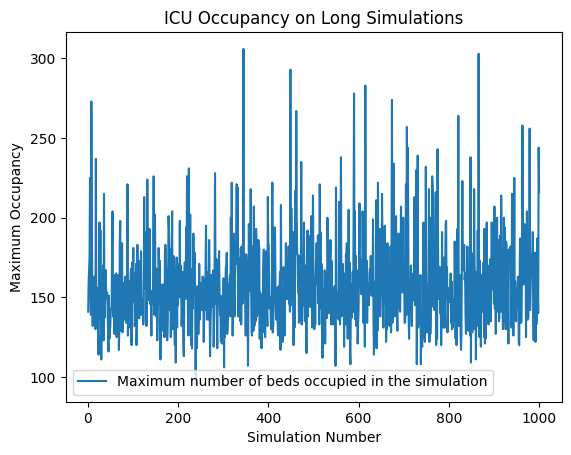

In [ ]:
# Plot the maximum occupancy during simulations
number_of_simulations = np.arange(1, num_simulations+1)

plt.plot(number_of_simulations, max_occupancy, label='Maximum number of beds occupied in the simulation')
plt.xlabel('Simulation Number')
plt.ylabel('Maximum Occupancy')
plt.title('ICU Occupancy on Long Simulations')
plt.legend()
plt.show()

In [ ]:
max(max_occupancy)

306

In [ ]:
min(max_occupancy)

95

## **Statistical Analysis of the Result of Ensemble of Simulations**

In [ ]:
import statistics
from statistics import mean
mean(max_occupancy)

158

In [ ]:
max_array = np.asarray(max_occupancy)
new_dataframe = pd.DataFrame({'Max_Occupancy': max_array})
pre_stat_df = new_dataframe.describe()
pre_stat_df

,Max_Occupancy
count,1000.00000
mean,44.89000
std,2.33567
min,39.00000
25%,43.00000
50%,45.00000
75%,46.00000
max,55.00000


In [ ]:
new_dataframe.head(100)

,Max_Occupancy
0,141
1,160
2,168
3,175
4,225
...,...
95,168
96,120
97,167
98,172


In [ ]:
new_dataframe['Max_Occupancy'].value_counts

<bound method IndexOpsMixin.value_counts of 0      141
1      160
2      168
3      175
4      225
      ... 
995    187
996    154
997    140
998    244
999    216
Name: Max_Occupancy, Length: 1000, dtype: int64>

In [ ]:
new_dataframe.loc[new_dataframe['Max_Occupancy']>= 1.2406 * mean(max_occupancy)]

,Max_Occupancy
4,225
7,273
17,237
25,197
35,215
...,...
963,221
972,204
978,256
998,244


In [ ]:
1.2406 * mean(max_occupancy)

196.01479999999998

In [ ]:
new_dataframe.loc[new_dataframe['Max_Occupancy']>= 1.3608 * mean(max_occupancy)]

,Max_Occupancy
4,225
7,273
17,237
87,221
131,224
145,226
219,226
223,231
281,228
318,222


In [ ]:
1.3608 * mean(max_occupancy)

215.0064

In [ ]:
data_table.enable_dataframe_formatter()
dict = {
        'Max_Occupancy':[196, 215]
       }

df_attached = pd.DataFrame(dict)
Statistic_df = pd.concat([pre_stat_df.iloc[:-1], df_attached, pre_stat_df.iloc[-1:]]).set_index(pd.Series(['No. of Simulations', 'mean', 'std', 'min', '25%' , '50%', '75%' , '90%' , '95%', 'max']))
Statistic_df

,Max_Occupancy
No. of Simulations,1000.000000
mean,158.471000
std,28.913408
min,95.000000
25%,138.000000
50%,154.000000
75%,171.000000
90%,196.000000
95%,215.000000
max,306.000000


In [ ]:
from google.colab import data_table
data_table.disable_dataframe_formatter()

Statistic_df

,Max_Occupancy
No. of Simulations,1000.000000
mean,23.317000
std,3.988787
min,16.000000
25%,21.000000
50%,23.000000
75%,25.000000
90%,28.000000
95%,30.000000
max,54.000000


# **This is another PANDEMIC simulation with a designed mean and standard deviation for a log-normal distribution of admission rates:**
 *   **"Designed $\mu$ parameter" = 3.29**
 *   **"Designed $\sigma$ parameter" = 0.5**

## **Rnning one simulation for 365 days**

In [ ]:
from pickle import FALSE
import random
import simpy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime, timedelta


In [ ]:
# Calculate the admission rates

avg_emergency_admission = 6246/5114
avg_planned_admission = 16860/3556
emergency_mu_parameter = np.log(avg_emergency_admission)
planned_mu_parameter = np.log(avg_planned_admission)
pandemic_mu_parameter = 2*(planned_mu_parameter + emergency_mu_parameter)
designed_mu_parameter = 3.29
designed_sigma_parameter = 0.5



# Define the number of ICU beds
icu_beds = 20

# Initialize the extra_beds_needed variable
extra_beds_needed = 1


In [ ]:
# Function to simulate ICU admissions for a given day
def simulate_admissions(env, real_data, use_poisson_distribution,pandemic, mean_length_of_stay):
    # Get the current date and check if it's a weekday or weekend
    current_day = env.now  # Increment by 1 since simulation starts from day 0
    is_weekday = current_day % 7 < 5  # Monday = 0, ..., Friday = 4


    #print(f'today value is{current_day}')

    # Define the planned admission rate (number of planned admissions per weekday)
    planned_admission_rate = round(np.random.lognormal(planned_mu_parameter,sigma=0.5))

    # Define the number of emergency admissions per day (can vary)
    emergency_admission_rate = round(np.random.lognormal(emergency_mu_parameter,sigma=0.5))

    # Define the pandemic admission rate (number of pandemic admissions)
    pandemic_admission_rate = round(np.random.lognormal(pandemic_mu_parameter,sigma=0.5))

     # Define the designed pandemic admission rate (number of designed pandemic admissions)
    #designed_pandemic_admission_rate = round(1000 * np.random.lognormal(designed_mu_parameter,sigma=designed_sigma_parameter))

    # Simulate ICU admissions for the day
    if use_poisson_distribution:
        if pandemic:
          if designed_pandemic:
            if current_day == 0:
              designed_pandemic_admission_rate =0
            else:
              designed_pandemic_admission_rate = round((1000* np.exp(-((np.log(current_day)-designed_mu_parameter)**2)/(2*(designed_sigma_parameter)**2)))/(current_day*designed_sigma_parameter*np.sqrt(2*np.pi)))

            admissions = np.random.poisson(mean_length_of_stay, designed_pandemic_admission_rate)
          else:
            admissions = np.random.poisson(mean_length_of_stay, pandemic_admission_rate)
        else:
          admissions_emergency = np.random.poisson(mean_length_of_stay, emergency_admission_rate)
          admissions_planned = np.random.poisson(mean_length_of_stay, planned_admission_rate)
          # Calculate the total admission rate based on the type of admission
          if is_weekday:
            admissions = np.append(admissions_emergency, admissions_planned)
          else:
            admissions = admissions_emergency

          print(f"admission was selected from a random Poisson distribution with mean ={mean_length_of_stay}")
    else:
        if pandemic:
          if designed_pandemic:
            if current_day == 0:
              designed_pandemic_admission_rate =0
            else:
              designed_pandemic_admission_rate = round((1000* np.exp(-((np.log(current_day)-designed_mu_parameter)**2)/(2*(designed_sigma_parameter)**2)))/(current_day*designed_sigma_parameter*np.sqrt(2*np.pi)))

            admissions = np.random.choice(pandemic_length_of_stay_distribution, size = designed_pandemic_admission_rate, p=pandemic_probability_length_of_stay_data_array)
          else:
            admissions = np.random.choice(pandemic_length_of_stay_distribution, size = pandemic_admission_rate, p=pandemic_probability_length_of_stay_data_array)
        else:

          admissions_emergency = np.random.choice(emergency_length_of_stay_distribution, size = emergency_admission_rate, p=emergency_probability_length_of_stay_data_array)
          admissions_planned = np.random.choice(planned_length_of_stay_distribution, size = planned_admission_rate, p=planned_probability_length_of_stay_data_array)
          # Calculate the total admission rate based on the type of admission
          if is_weekday:
            admissions = np.append(admissions_emergency, admissions_planned)
            #print(f'admission on weekday')
            #print(f'number of admissions:{len(admissions)}')
          else:
            admissions = admissions_emergency
            #print(f'admission on not_a_weekday')
            #print(f'number of admissions:{len(admissions)}')

            #admissions = np.random.choice(length_of_stay_distribution, size = total_admission_rate, p=probability_length_of_stay_data_array)
            #print(f'admission:{admissions}')
    admission_priority = [0] * planned_admission_rate + [1] * emergency_admission_rate

    return admissions, admission_priority, pandemic_admission_rate, designed_pandemic_admission_rate

In [ ]:
# Function to update occupancy and occupied beds
def update_occupancy(admissions, icu_beds_capacity, occupied_beds):
    # Extend occupied_beds by admissions
    occupied_beds.extend(admissions)
    beginning_of_day_occupancy = len(occupied_beds)

    # Check if the size of ocupied_beds is smaller than the number of icu_beds
 #   if len(occupied_beds) < icu_beds_capacity.capacity:
        # Change occupied_beds to a list only containing values bigger than 24
        # and subtract 24 from the remaining values
    occupied_beds = [(val - 24) for val in occupied_beds if val > 24]

    end_of_day_occupancy = len(occupied_beds)
    discharged = beginning_of_day_occupancy - end_of_day_occupancy
    occupancy = beginning_of_day_occupancy - discharged



    return beginning_of_day_occupancy, occupancy, occupied_beds



In [ ]:
# Simulation process
def simulate_icu_occupancy(env, icu_beds_capacity, extra_beds_needed, mean_length_of_stay):
    occupancy = 0
    occupied_beds = []
    bed_capacity_reached = False

    half_time = 365 / 2

    current_day = 0  # Initialize current_day to 0, SIMULATION STARTS ON MONDAY

    while True:
        admissions, admission_priority, pandemic_admission_rate, designed_pandemic_admission_rate = simulate_admissions(env, real_data, use_poisson_distribution,pandemic, mean_length_of_stay)

        with icu_beds_capacity.request(priority=max(admission_priority)) as request:
            yield request

            beginning_of_day_occupancy, occupancy, occupied_beds = update_occupancy(admissions, icu_beds_capacity, occupied_beds)

            # Append data to occupancy and bed capacity lists
            occupancy_BOD_data.append(beginning_of_day_occupancy)
            occupancy_EOD_data.append(occupancy)
            bed_capacity_data.append(icu_beds_capacity.capacity)
            #admission_rate_data.append(total_admission_rate)
            emergency_admissions_rate_data.append(admission_priority.count(1))
            planned_admissions_rate_data.append(admission_priority.count(0))
            pandemic_admissions_rate_data.append(pandemic_admission_rate)
            designed_pandemic_admissions_rate_data.append(designed_pandemic_admission_rate)







        yield env.timeout(1)
        current_day += 1  # Increment current_day by 1 after each simulation loop

In [ ]:
# Define the length of stay distribution

use_poisson_distribution = False
real_data = True
pandemic = True
designed_pandemic = True
if pandemic:
  if designed_pandemic:
    print(f'THIS IS A DESIGNED PANDEMIC')
  else:
    print(f'THIS IS A PANDEMIC SITUATION')

mean_length_of_stay = 22

if use_poisson_distribution:
    mean_length_of_stay = 22  # Mean length of stay for Poisson distribution

elif real_data :     # Set to True if using real data

    emergency_length_of_stay_data = df_admission_emergency['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    emergency_probability_length_of_stay_data = df_admission_emergency['probability']

    emergency_length_of_stay_data_array = emergency_length_of_stay_data.values
    emergency_probability_length_of_stay_data_array = emergency_probability_length_of_stay_data.values

    planned_length_of_stay_data = df_admission_planned['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    planned_probability_length_of_stay_data = df_admission_planned['probability']

    planned_length_of_stay_data_array = planned_length_of_stay_data.values
    planned_probability_length_of_stay_data_array = planned_probability_length_of_stay_data.values

    pandemic_length_of_stay_data = df_admission_ards['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    pandemic_probability_length_of_stay_data = df_admission_ards['probability']

    pandemic_length_of_stay_data_array = pandemic_length_of_stay_data.values
    pandemic_probability_length_of_stay_data_array = pandemic_probability_length_of_stay_data.values


    # Normalize the probabilities
    emergency_probability_length_of_stay_data_array /= np.sum(emergency_probability_length_of_stay_data_array)
    planned_probability_length_of_stay_data_array /= np.sum(planned_probability_length_of_stay_data_array)
    pandemic_probability_length_of_stay_data_array /= np.sum(pandemic_probability_length_of_stay_data.array)

    emergency_length_of_stay_distribution = emergency_length_of_stay_data_array

    planned_length_of_stay_distribution = planned_length_of_stay_data_array

    pandemic_length_of_stay_distribution = pandemic_length_of_stay_data_array

    if pandemic:
      print(f"Admissions were selected from a choice of real data based on a log-normal distributaion with sigma = 0.5 and mu = {pandemic_mu_parameter} for pandemic admissions.")
    else:
      print(f"Admissions were selected from a choice of real data based on a log-normal distributaion with sigma = 0.5 and mu = ({planned_mu_parameter},{emergency_mu_parameter}) for planned and emergency admissions respectively.")
else:
    emergency_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    planned_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    pandemic_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    print(f"Admissions was selected from a random selection of random integer numbers")


THIS IS A DESIGNED PANDEMIC
Admissions were selected from a choice of real data based on a log-normal distributaion with sigma = 0.5 and mu = 3.5125340338278868 for pandemic admissions.


In [ ]:
# Create lists to store occupancy and bed capacity data
occupancy_BOD_data = []
occupancy_EOD_data = []
bed_capacity_data = []
#admission_rate_data = []
emergency_admissions_rate_data = []
planned_admissions_rate_data = []
pandemic_admissions_rate_data = []
designed_pandemic_admissions_rate_data = []


In [ ]:
# Run the simulation
env = simpy.Environment()
icu_beds_capacity = simpy.PriorityResource(env, capacity=icu_beds)
extra_beds_needed = simpy.Resource(env, capacity=extra_beds_needed)
simulation = env.process(simulate_icu_occupancy(env, icu_beds_capacity, extra_beds_needed,  mean_length_of_stay))
env.run(until=365)


In [ ]:
# Print the simulation results

# Create a pandas DataFrame
data = {'Designed Pandemic admissions': designed_pandemic_admissions_rate_data,'Beds occupied during the day': occupancy_BOD_data, 'Occupancy at the end of day': occupancy_EOD_data, 'Bed Capacity': bed_capacity_data}
df_data = pd.DataFrame(data)

# Print the DataFrame
df_data


,Designed Pandemic admissions,Beds occupied during the day,Occupancy at the end of day,Bed Capacity
0,0,0,0,20
1,0,0,0,20
2,0,0,0,20
3,0,0,0,20
4,0,0,0,20
...,...,...,...,...
360,0,0,0,20
361,0,0,0,20
362,0,0,0,20
363,0,0,0,20


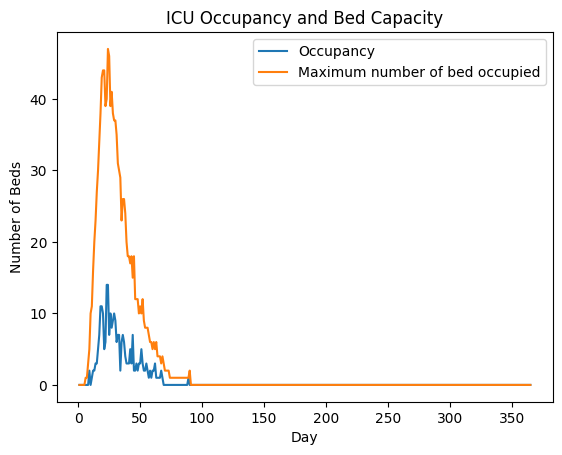

In [ ]:
# Plot the occupancy and bed capacity data
days = np.arange(1, len(occupancy_EOD_data) + 1)

plt.plot(days, occupancy_EOD_data, label='Occupancy')
plt.plot(days, occupancy_BOD_data, label='Maximum number of bed occupied')
plt.xlabel('Day')
plt.ylabel('Number of Beds')
plt.title('ICU Occupancy and Bed Capacity')
plt.legend()
plt.show()

## **Running 1000 simulations and creating a simulation ensemble for statistical analysis**

In [ ]:
from pickle import FALSE
import random
import simpy
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from datetime import datetime, timedelta






# Calculate the admission rates
#avg_emergency_admission = round(6246/5114,2)
#avg_planned_admission = round(16860/3556,2)
avg_emergency_admission = 6246/5114
avg_planned_admission = 16860/3556
emergency_mu_parameter = np.log(avg_emergency_admission)
planned_mu_parameter = np.log(avg_planned_admission)
pandemic_mu_parameter = 2*(planned_mu_parameter + emergency_mu_parameter)
designed_mu_parameter = 3.29
designed_sigma_parameter = 0.5




# Define the number of ICU beds
icu_beds = 20

# Initialize the extra_beds_needed variable
extra_beds_capacity = 1

# Create lists to store occupancy and bed capacity data for each run
all_occupancy_BOD_data = []
all_occupancy_EOD_data = []
all_bed_capacity_data = []
#all_admission_rate_data = []
all_emergency_admissions_rate_data = []
all_planned_admissions_rate_data = []
all_pandemic_admissions_rate_data = []
all_designed_pandemic_admissions_rate_data = []


# Function to simulate ICU admissions for a given day
def simulate_admissions(env, real_data, use_poisson_distribution,pandemic, mean_length_of_stay):
    # Get the current date and check if it's a weekday or weekend
    current_day = env.now  # Increment by 1 since simulation starts from day 0
    is_weekday = current_day % 7 < 5  # Monday = 0, ..., Friday = 4


    #print(f'today value is{current_day}')

    # Define the planned admission rate (number of planned admissions per weekday)
    planned_admission_rate = round(np.random.lognormal(planned_mu_parameter,sigma=0.5))

    # Define the number of emergency admissions per day (can vary)
    emergency_admission_rate = round(np.random.lognormal(emergency_mu_parameter,sigma=0.5))

    # Define the pandemic admission rate (number of pandemic admissions)
    pandemic_admission_rate = round(np.random.lognormal(pandemic_mu_parameter,sigma=0.5))

     # Define the designed pandemic admission rate (number of designed pandemic admissions)
    #designed_pandemic_admission_rate = round(1000 * np.random.lognormal(designed_mu_parameter,sigma=designed_sigma_parameter))

    # Simulate ICU admissions for the day
    if use_poisson_distribution:
        if pandemic:
          if designed_pandemic:
            if current_day == 0:
              designed_pandemic_admission_rate =0
            else:
              designed_pandemic_admission_rate = round((1000* np.exp(-((np.log(current_day)-designed_mu_parameter)**2)/(2*(designed_sigma_parameter)**2)))/(current_day*designed_sigma_parameter*np.sqrt(2*np.pi)))

            admissions = np.random.poisson(mean_length_of_stay, designed_pandemic_admission_rate)
          else:
            admissions = np.random.poisson(mean_length_of_stay, pandemic_admission_rate)
        else:
          admissions_emergency = np.random.poisson(mean_length_of_stay, emergency_admission_rate)
          admissions_planned = np.random.poisson(mean_length_of_stay, planned_admission_rate)
          # Calculate the total admission rate based on the type of admission
          if is_weekday:
            admissions = np.append(admissions_emergency, admissions_planned)
          else:
            admissions = admissions_emergency

          print(f"admission was selected from a random Poisson distribution with mean ={mean_length_of_stay}")
    else:
        if pandemic:
          if designed_pandemic:
            if current_day == 0:
              designed_pandemic_admission_rate =0
            else:
              designed_pandemic_admission_rate = round((1000* np.exp(-((np.log(current_day)-designed_mu_parameter)**2)/(2*(designed_sigma_parameter)**2)))/(current_day*designed_sigma_parameter*np.sqrt(2*np.pi)))

            admissions = np.random.choice(pandemic_length_of_stay_distribution, size = designed_pandemic_admission_rate, p=pandemic_probability_length_of_stay_data_array)
          else:
            admissions = np.random.choice(pandemic_length_of_stay_distribution, size = pandemic_admission_rate, p=pandemic_probability_length_of_stay_data_array)
        else:

          admissions_emergency = np.random.choice(emergency_length_of_stay_distribution, size = emergency_admission_rate, p=emergency_probability_length_of_stay_data_array)
          admissions_planned = np.random.choice(planned_length_of_stay_distribution, size = planned_admission_rate, p=planned_probability_length_of_stay_data_array)
          # Calculate the total admission rate based on the type of admission
          if is_weekday:
            admissions = np.append(admissions_emergency, admissions_planned)
            #print(f'admission on weekday')
            #print(f'number of admissions:{len(admissions)}')
          else:
            admissions = admissions_emergency
            #print(f'admission on not_a_weekday')
            #print(f'number of admissions:{len(admissions)}')

            #admissions = np.random.choice(length_of_stay_distribution, size = total_admission_rate, p=probability_length_of_stay_data_array)
            #print(f'admission:{admissions}')
    admission_priority = [0] * planned_admission_rate + [1] * emergency_admission_rate

    return admissions, admission_priority, pandemic_admission_rate, designed_pandemic_admission_rate


# Function to update occupancy and occupied beds
def update_occupancy(admissions, icu_beds_capacity, occupied_beds):
    # Extend occupied_beds by admissions
    occupied_beds.extend(admissions)
    beginning_of_day_occupancy = len(occupied_beds)

    # Check if the size of ocupied_beds is smaller than the number of icu_beds
 #   if len(occupied_beds) < icu_beds_capacity.capacity:
        # Change occupied_beds to a list only containing values bigger than 24
        # and subtract 24 from the remaining values
    occupied_beds = [(val - 24) for val in occupied_beds if val > 24]

    end_of_day_occupancy = len(occupied_beds)
    discharged = beginning_of_day_occupancy - end_of_day_occupancy
    occupancy = beginning_of_day_occupancy - discharged



    return beginning_of_day_occupancy, occupancy, occupied_beds



# Simulation process
def simulate_icu_occupancy(env, icu_beds_capacity, extra_beds_needed, mean_length_of_stay):
    occupancy = 0
    occupied_beds = []
    bed_capacity_reached = False

    half_time = 365 / 2

    current_day = 0  # Initialize current_day to 0, SIMULATION STARTS ON MONDAY

    while True:
        admissions, admission_priority, pandemic_admission_rate, designed_pandemic_admission_rate = simulate_admissions(env, real_data, use_poisson_distribution,pandemic, mean_length_of_stay)

        with icu_beds_capacity.request(priority=max(admission_priority)) as request:
            yield request

            beginning_of_day_occupancy, occupancy, occupied_beds = update_occupancy(admissions, icu_beds_capacity, occupied_beds)

            # Append data to occupancy and bed capacity lists
            occupancy_BOD_data.append(beginning_of_day_occupancy)
            occupancy_EOD_data.append(occupancy)
            bed_capacity_data.append(icu_beds_capacity.capacity)
            #admission_rate_data.append(total_admission_rate)
            emergency_admissions_rate_data.append(admission_priority.count(1))
            planned_admissions_rate_data.append(admission_priority.count(0))
            pandemic_admissions_rate_data.append(pandemic_admission_rate)
            designed_pandemic_admissions_rate_data.append(designed_pandemic_admission_rate)







        yield env.timeout(1)
        current_day += 1  # Increment current_day by 1 after each simulation loop

# Define the length of stay distribution

use_poisson_distribution = False
real_data = True
pandemic = True
designed_pandemic = True
if pandemic:
  if designed_pandemic:
    print(f'THIS IS A DESIGNED PANDEMIC')
  else:
    print(f'THIS IS A PANDEMIC SITUATION')

mean_length_of_stay = 22

if use_poisson_distribution:
    mean_length_of_stay = 22  # Mean length of stay for Poisson distribution

elif real_data :     # Set to True if using real data

    emergency_length_of_stay_data = df_admission_emergency['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    emergency_probability_length_of_stay_data = df_admission_emergency['probability']

    emergency_length_of_stay_data_array = emergency_length_of_stay_data.values
    emergency_probability_length_of_stay_data_array = emergency_probability_length_of_stay_data.values

    planned_length_of_stay_data = df_admission_planned['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    planned_probability_length_of_stay_data = df_admission_planned['probability']

    planned_length_of_stay_data_array = planned_length_of_stay_data.values
    planned_probability_length_of_stay_data_array = planned_probability_length_of_stay_data.values

    pandemic_length_of_stay_data = df_admission_ards['lengthofstay']  # Assuming 'lengthofstay' is the column name in the DataFrame
    pandemic_probability_length_of_stay_data = df_admission_ards['probability']

    pandemic_length_of_stay_data_array = pandemic_length_of_stay_data.values
    pandemic_probability_length_of_stay_data_array = pandemic_probability_length_of_stay_data.values


    # Normalize the probabilities
    emergency_probability_length_of_stay_data_array /= np.sum(emergency_probability_length_of_stay_data_array)
    planned_probability_length_of_stay_data_array /= np.sum(planned_probability_length_of_stay_data_array)
    pandemic_probability_length_of_stay_data_array /= np.sum(pandemic_probability_length_of_stay_data.array)

    emergency_length_of_stay_distribution = emergency_length_of_stay_data_array

    planned_length_of_stay_distribution = planned_length_of_stay_data_array

    pandemic_length_of_stay_distribution = pandemic_length_of_stay_data_array

    if pandemic:
      print(f"Admissions were selected from a choice of real data based on a log-normal distributaion with sigma = 0.5 and mu = {pandemic_mu_parameter} for pandemic admissions.")
    else:
      print(f"Admissions were selected from a choice of real data based on a log-normal distributaion with sigma = 0.5 and mu = ({planned_mu_parameter},{emergency_mu_parameter}) for planned and emergency admissions respectively.")
else:
    emergency_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    planned_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    pandemic_length_of_stay_distribution = np.random.randint(0, 50, size=(1, 10))
    print(f"Admissions was selected from a random selection of random integer numbers")


# Set the number of simulations
num_simulations = 1000

# Run the simulations
for i in range(num_simulations):
    # Create a new environment for each simulation
    env = simpy.Environment()
    icu_beds_capacity = simpy.PriorityResource(env, capacity=icu_beds)
    extra_beds_needed = simpy.Resource(env, capacity=extra_beds_capacity)

    # Reset the data lists for each simulation
    occupancy_BOD_data = []
    occupancy_EOD_data = []
    bed_capacity_data = []
    emergency_admissions_rate_data = []
    planned_admissions_rate_data = []
    pandemic_admissions_rate_data = []
    designed_pandemic_admissions_rate_data = []

    # Run the simulation
    simulation = env.process(simulate_icu_occupancy(env, icu_beds_capacity, extra_beds_needed, mean_length_of_stay))
    env.run(until=365)

    # Append the data of each simulation to the all_* data lists
    all_occupancy_BOD_data.append(occupancy_BOD_data)
    all_occupancy_EOD_data.append(occupancy_EOD_data)
    all_bed_capacity_data.append(bed_capacity_data)
    #all_admission_rate_data.append(admission_rate_data)
    all_emergency_admissions_rate_data.append(emergency_admissions_rate_data)
    all_planned_admissions_rate_data.append(planned_admissions_rate_data)
    all_pandemic_admissions_rate_data.append(pandemic_admissions_rate_data)
    all_designed_pandemic_admissions_rate_data.append(designed_pandemic_admissions_rate_data)

# Create a pandas DataFrame for each simulation
all_dataframes = []

for i in range(num_simulations):
    if pandemic:
      if designed_pandemic:
        data = {
        'Pandemic admissions': all_designed_pandemic_admissions_rate_data[i],
        'Beds occupied during the day': all_occupancy_BOD_data[i],
        'Occupancy at the end of day': all_occupancy_EOD_data[i]}
      else:
        data = {
        'Pandemic admissions': all_pandemic_admissions_rate_data[i],
        'Beds occupied during the day': all_occupancy_BOD_data[i],
        'Occupancy at the end of day': all_occupancy_EOD_data[i]}
    else:
      data = {
        'Planned admissions': all_planned_admissions_rate_data[i],
        'Emergency admissions': all_emergency_admissions_rate_data[i],
        'Beds occupied during the day': all_occupancy_BOD_data[i],
        'Occupancy at the end of day': all_occupancy_EOD_data[i]}

    df = pd.DataFrame(data)
    all_dataframes.append(df)

# Print the DataFrame for each simulation
#for i in range(num_simulations):
#   print(f"Simulation {i+1}:")
#   print(all_dataframes[i])
#   print()

# Calculate and return the maximum occupancy
max_occupancy =[]
for i in range(num_simulations):
    max_occupancy.append(all_dataframes[i]['Beds occupied during the day'].max())

#print(f'max_occupancy:{max_occupancy}')


THIS IS A DESIGNED PANDEMIC
Admissions were selected from a choice of real data based on a log-normal distributaion with sigma = 0.5 and mu = 3.5125340338278868 for pandemic admissions.


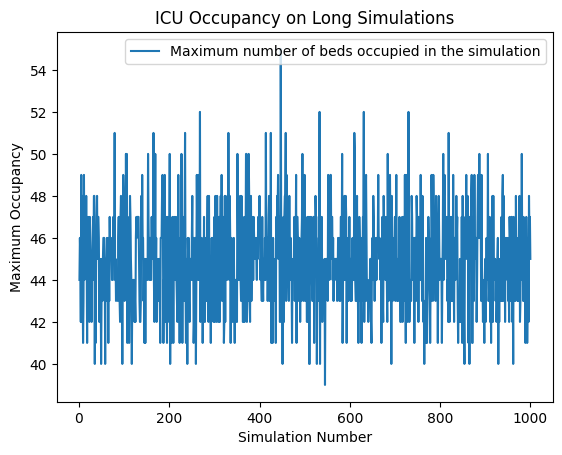

In [ ]:
# Plot the maximum occupancy during simulations
number_of_simulations = np.arange(1, num_simulations+1)

plt.plot(number_of_simulations, max_occupancy, label='Maximum number of beds occupied in the simulation')
plt.xlabel('Simulation Number')
plt.ylabel('Maximum Occupancy')
plt.title('ICU Occupancy on Long Simulations')
plt.legend()
plt.show()

In [ ]:
max_array = np.asarray(max_occupancy)
new_dataframe = pd.DataFrame({'Max_Occupancy': max_array})
pre_stat_df = new_dataframe.describe()
pre_stat_df

,Max_Occupancy
count,1000.00000
mean,44.89000
std,2.33567
min,39.00000
25%,43.00000
50%,45.00000
75%,46.00000
max,55.00000


In [ ]:
new_dataframe.loc[new_dataframe['Max_Occupancy']>= 1.09091 * mean(max_occupancy)]

,Max_Occupancy
4,49
10,49
78,51
97,49
103,50
...,...
886,50
891,49
905,50
938,49


In [ ]:
1.09091 * mean(max_occupancy)

48.00004

In [ ]:
new_dataframe.loc[new_dataframe['Max_Occupancy']>= 1.11364 * mean(max_occupancy)]

,Max_Occupancy
78,51
103,50
105,50
152,50
164,51
168,50
200,50
226,50
234,51
267,52


In [ ]:
1.11364 * mean(max_occupancy)

49.00016

In [ ]:
data_table.enable_dataframe_formatter()
dict = {
        'Max_Occupancy':[48, 49]
       }

df_attached = pd.DataFrame(dict)
Statistic_df = pd.concat([pre_stat_df.iloc[:-1], df_attached, pre_stat_df.iloc[-1:]]).set_index(pd.Series(['No. of Simulations', 'mean', 'std', 'min', '25%' , '50%', '75%' , '90%' , '95%', 'max']))
Statistic_df

,Max_Occupancy
No. of Simulations,1000.00000
mean,44.89000
std,2.33567
min,39.00000
25%,43.00000
50%,45.00000
75%,46.00000
90%,48.00000
95%,49.00000
max,55.00000
